In [ ]:

import requests
url = "http://mklab.iti.gr/files/imageblur/CERTH_ImageBlurDataset.zip"
r = requests.get(url, stream = True)
with open("/content/drive/My Drive/CERTH_ImageBlurDataset.zip", "wb") as file:  
    for block in r.iter_content(chunk_size = 1024): 
         if block:  
             file.write(block)

In [ ]:
# Import PyDrive and associated libraries.
# This only needs to be done once per notebook.
from pydrive.auth import GoogleAuth
from pydrive.drive import GoogleDrive
from google.colab import auth
from oauth2client.client import GoogleCredentials

# Authenticate and create the PyDrive client.
# This only needs to be done once per notebook.
auth.authenticate_user()
gauth = GoogleAuth()
gauth.credentials = GoogleCredentials.get_application_default()
drive = GoogleDrive(gauth)

# Download a file based on its file ID.
#
# A file ID looks like: laggVyWshwcyP6kEI-y_W3P8D26sz
file_id = '1-BjXL4RjoWSdf7_9lKiyFFaVhCZ0MVMw'
downloaded = drive.CreateFile({'id': file_id})
print('Downloaded content "{}"'.format(downloaded.GetContentString()))

UnicodeDecodeError: ignored

In [ ]:
!unzip "/content/drive/My Drive/CERTH_ImageBlurDataset.zip" -d "/content/drive/My Drive"

Archive:  /content/drive/My Drive/CERTH_ImageBlurDataset.zip
   creating: /content/drive/My Drive/CERTH_ImageBlurDataset/
   creating: /content/drive/My Drive/CERTH_ImageBlurDataset/EvaluationSet/
   creating: /content/drive/My Drive/CERTH_ImageBlurDataset/EvaluationSet/DigitalBlurSet/
  inflating: /content/drive/My Drive/CERTH_ImageBlurDataset/EvaluationSet/DigitalBlurSet/DiskR10_1.jpg  
  inflating: /content/drive/My Drive/CERTH_ImageBlurDataset/EvaluationSet/DigitalBlurSet/DiskR10_10.jpg  
  inflating: /content/drive/My Drive/CERTH_ImageBlurDataset/EvaluationSet/DigitalBlurSet/DiskR10_11.jpg  
  inflating: /content/drive/My Drive/CERTH_ImageBlurDataset/EvaluationSet/DigitalBlurSet/DiskR10_12.jpg  
  inflating: /content/drive/My Drive/CERTH_ImageBlurDataset/EvaluationSet/DigitalBlurSet/DiskR10_13.jpg  
  inflating: /content/drive/My Drive/CERTH_ImageBlurDataset/EvaluationSet/DigitalBlurSet/DiskR10_14.jpg  
  inflating: /content/drive/My Drive/CERTH_ImageBlurDataset/EvaluationSet/Digi

In [33]:
import tensorflow as tf
import cv2 
import matplotlib.pyplot as plt
import os
import numpy as np 
from sklearn.utils import shuffle
from sklearn.preprocessing import OneHotEncoder
from tensorflow import keras
import matplotlib.gridspec as gridspec
from random import randint
from keras.utils import to_categorical
from tensorflow.keras import layers, models

In [34]:
def get_images(directory):
    images = []
    labels = []
    for dir in os.listdir(directory):
        label = -1
        if(dir == "Naturally-Blurred"):
            label = 1
        if(dir == "Artificially-Blurred"):
            label = 1
        if(dir == "Undistorted"):
            label = 0
        if(dir == "README.txt"):
            continue
        for image_dir in os.listdir(directory +"//"+ dir):
            image = cv2.imread(directory +"//"+ dir + "//"+ image_dir)
            image = cv2.resize(image, (150, 150))
            image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
            image = cv2.Laplacian(image,cv2.CV_64FC2)
            images.append(image)
            labels.append(label)
    return shuffle(images, labels)

In [35]:
train_images, train_labels = get_images("/content/drive/My Drive/CERTH_ImageBlurDataset/TrainingSet")
train_images = np.array(train_images)
train_images = train_images.reshape((1000, 150, 150, 1))
train_labels = np.array(train_labels)

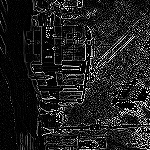

In [36]:
from google.colab.patches import cv2_imshow
cv2_imshow(train_images[659])

In [37]:
print(train_images.shape)
print(train_labels.shape)

(1000, 150, 150, 1)
(1000,)


In [38]:
train_images = train_images.astype('float32')
train_images /= 255.0

In [39]:
model = models.Sequential()
model.add(layers.Conv2D(filters = 32, kernel_size=(5,5), strides=(2, 2), activation='relu', input_shape=(150, 150, 1)))
model.add(layers.BatchNormalization())
model.add(layers.MaxPool2D(pool_size=(3,3), strides=(2,2)))
model.add(layers.Conv2D(filters=56, kernel_size=(3,3), strides=(1,1), activation='relu', padding='same'))
model.add(layers.BatchNormalization())
model.add(layers.MaxPool2D(pool_size=(3,3), strides=(1,1)))
model.add(layers.Conv2D(filters=96, kernel_size=(3,3), strides=(1, 1), activation='relu', padding='same'))
model.add(layers.BatchNormalization())
model.add(layers.MaxPool2D(pool_size=(3,3), strides=(1,1)))
model.add(layers.Flatten())
model.add(layers.Dense(1024, activation='relu'))
model.add(layers.Dropout(0.5))
model.add(layers.Dense(512, activation='relu'))
model.add(layers.Dropout(0.5))
model.add(layers.Dense(256, activation='relu'))
model.add(layers.Dropout(0.5))
model.add(layers.Dense(1, activation='sigmoid'))

In [40]:
model.compile(optimizer=keras.optimizers.Adam(learning_rate=0.0001), loss=keras.losses.BinaryCrossentropy(), metrics=['accuracy'])
model.summary()

Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_19 (Conv2D)           (None, 73, 73, 32)        832       
_________________________________________________________________
batch_normalization_19 (Batc (None, 73, 73, 32)        128       
_________________________________________________________________
max_pooling2d_17 (MaxPooling (None, 36, 36, 32)        0         
_________________________________________________________________
conv2d_20 (Conv2D)           (None, 36, 36, 56)        16184     
_________________________________________________________________
batch_normalization_20 (Batc (None, 36, 36, 56)        224       
_________________________________________________________________
max_pooling2d_18 (MaxPooling (None, 34, 34, 56)        0         
_________________________________________________________________
conv2d_21 (Conv2D)           (None, 34, 34, 96)       

In [41]:
trained = model.fit(train_images, train_labels, epochs = 22 ,validation_split = 0.1, batch_size=16)

Epoch 1/22
57/57 [==============================] - 3s 34ms/step - loss: 4.8050 - accuracy: 0.6571 - val_loss: 12.7758 - val_accuracy: 0.3900
Epoch 2/22
57/57 [==============================] - 2s 30ms/step - loss: 4.8665 - accuracy: 0.7171 - val_loss: 19.5849 - val_accuracy: 0.3900
Epoch 3/22
57/57 [==============================] - 2s 30ms/step - loss: 4.4401 - accuracy: 0.7207 - val_loss: 19.7029 - val_accuracy: 0.3900
Epoch 4/22
57/57 [==============================] - 2s 30ms/step - loss: 4.2410 - accuracy: 0.7424 - val_loss: 30.7936 - val_accuracy: 0.3900
Epoch 5/22
57/57 [==============================] - 2s 30ms/step - loss: 3.2737 - accuracy: 0.7744 - val_loss: 27.9369 - val_accuracy: 0.3900
Epoch 6/22
57/57 [==============================] - 2s 30ms/step - loss: 2.3037 - accuracy: 0.7882 - val_loss: 19.9705 - val_accuracy: 0.3900
Epoch 7/22
57/57 [==============================] - 2s 30ms/step - loss: 2.4816 - accuracy: 0.7992 - val_loss: 12.0317 - val_accuracy: 0.4300
Epoch 

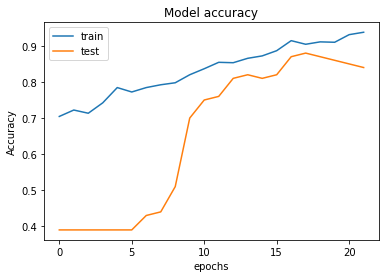

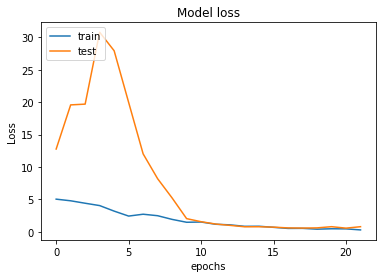

In [42]:
plt.plot(trained.history['accuracy'])
plt.plot(trained.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel("epochs")
plt.legend(['train', 'test'], loc = 'upper left')
plt.show()
plt.plot(trained.history['loss'])
plt.plot(trained.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('epochs')
plt.legend(['train','test'], loc = 'upper left')
plt.show()

In [ ]:
df1.head

NameError: ignored

In [43]:
import pandas as pd
def get_test():
    df = pd.read_excel("/content/drive/My Drive/CERTH_ImageBlurDataset/EvaluationSet/DigitalBlurSet.xlsx")
    df1 = pd.read_excel("/content/drive/My Drive/CERTH_ImageBlurDataset/EvaluationSet/NaturalBlurSet.xlsx")
    df = df.dropna()
    df1 = df1.dropna()
    images = []
    labels = []
    directory = "/content/drive/My Drive/CERTH_ImageBlurDataset/EvaluationSet"
    for dir in ["DigitalBlurSet", "NaturalBlurSet"]:
        for image_dir in os.listdir(directory +"//"+ dir):
            image = cv2.imread(directory +"//"+ dir + "//"+ image_dir)
            image = cv2.resize(image, (150,150))
            image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
            image = cv2.Laplacian(image, cv2.CV_64FC2)
            images.append(image)
            if(dir == "DigitalBlurSet"):
                mask = df['MyDigital Blur'] == image_dir+' '
                n = df[mask]
                if(n.values[0][1] == -1):
                  labels.append(0)
                else:
                  labels.append(1)
            if(dir == "NaturalBlurSet"):
                s = image_dir
                s = s[:len(image_dir) - 4]
                mask = df1['Image Name'] == s
                n = df1[mask]
                print(s)
                if(n.empty):
                  print('S'+s+'S')
                  print('S'+image_dir+'S')
                  break
                if(n.values[0][1] == -1):
                  labels.append(0)
                else:
                  labels.append(1)
    return (images, labels)

In [48]:
test_images, test_labels = get_test()
test_images = np.array(test_images)
print("hello")

Original_741
Original_742
Original_743
Original_746
Original_747
Original_749
Original_752
Original_744
Original_750
Original_1
Original_2
Original_3
Original_4
Original_5
Original_6
Original_994
Original_87
Original_88
Original_89
Original_90
Original_91
Original_92
Original_8
Original_9
Original_11
Original_12
Original_13
Original_14
Original_15
Original_16
Original_17
Original_18
Original_19
Original_20
Original_21
Original_23
Original_24
Original_25
Original_26
Original_27
Original_28
Original_30
Original_31
Original_32
Original_34
Original_36
Original_37
Original_38
Original_39
Original_40
Original_41
Original_42
Original_43
Original_44
Original_45
Original_46
Original_47
Original_48
Original_50
Original_51
Original_52
Original_53
Original_55
Original_57
Original_58
Original_59
Original_60
Original_61
Original_62
Original_63
Original_64
Original_67
Original_68
Original_70
Original_71
Original_72
Original_73
Original_74
Original_75
Original_76
Original_77
Original_78
Original_79
Or

(1480, 150, 150)


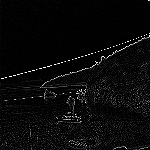

0


In [49]:
print(test_images.shape)
cv2_imshow(test_images[0])
print(test_labels[0])

In [50]:
test_images = test_images.reshape((1480,150,150,1))
test_images = test_images.astype('float32')
test_images /= 255.0
test_labels = np.array(test_labels)

In [51]:
model.evaluate(test_images, test_labels, verbose = 1)

47/47 [==============================] - 0s 10ms/step - loss: 0.7600 - accuracy: 0.8500


[0.7599502205848694, 0.8500000238418579]

In [ ]:
print(test_labels[0])

0


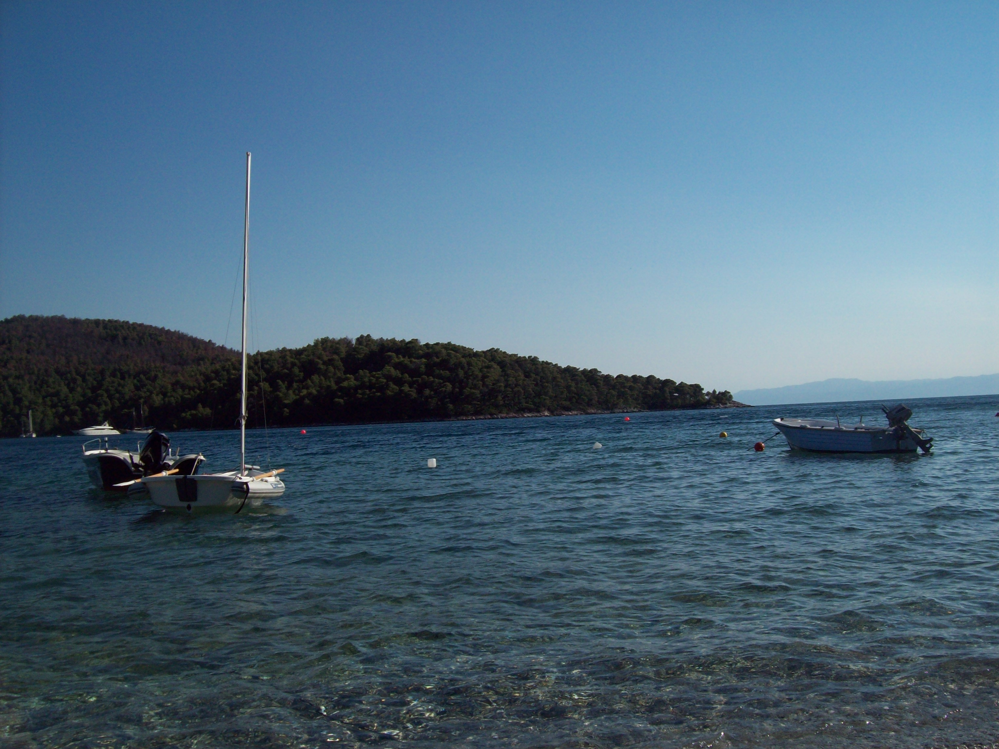

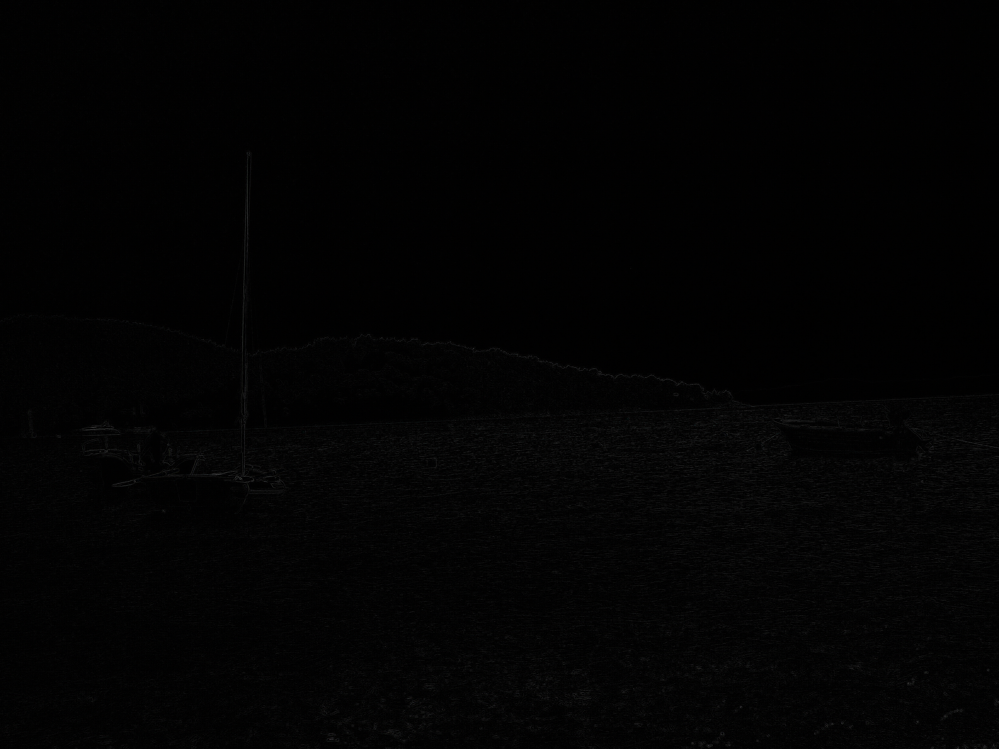

In [ ]:
test_im = cv2.imread("/content/drive/My Drive/CERTH_ImageBlurDataset/TrainingSet/Undistorted/100_2081.JPG")
#test_im1 = cv2.cvtColor(test_im, cv2.COLOR_BGR2GRAY)
test_im1 = cv2.Laplacian(test_im, cv2.CV_64FC4)
cv2_imshow(test_im)
cv2_imshow(test_im1)

In [ ]:
df.head

<bound method NDFrame.head of       MyDigital Blur  Unnamed: 1
0     DiskR10_1.jpg            1
1    DiskR10_10.jpg            1
2    DiskR10_11.jpg            1
3    DiskR10_12.jpg            1
4    DiskR10_13.jpg            1
..               ...         ...
475  Original_5.jpg           -1
476  Original_6.jpg           -1
477  Original_7.jpg           -1
478  Original_8.jpg           -1
479  Original_9.jpg           -1

[480 rows x 2 columns]>

In [ ]:
df = pd.read_excel("/content/drive/My Drive/CERTH_ImageBlurDataset/EvaluationSet/NaturalBlurSet.xlsx")
df.head


<bound method NDFrame.head of         Image Name  Blur Label
0       Original_1          -1
1       Original_2          -1
2       Original_3          -1
3       Original_4           1
4       Original_5           1
..             ...         ...
995   Original_996          -1
996   Original_997          -1
997   Original_998          -1
998   Original_999          -1
999  Original_1000           1

[1000 rows x 2 columns]>

In [ ]:
i = 'Original_777.jpg'
s = i[:len(i)-4]
mask = df['Image Name'] == s
n = df[mask]
print(n.values)
print(n.values[0][1])

[['Original_777' 1]]
1
